<a href="https://colab.research.google.com/github/zeusontop/ensemble-learning/blob/main/Electricity_Price_Competition_DecisionTreeRegressor.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This notebook is try to learn a model that outputs from these explanatory variables a good estimation for the daily price variation of electricity futures) contracts, in France and Germany.

# Data Preparation



1.   Loading libraries



In [1]:
import numpy as np
import pandas as pd
from scipy.stats import spearmanr
from sklearn.linear_model import LinearRegression
import matplotlib.pyplot as plt
import seaborn as sns

2.   loading data



*    X_train and X_test both have 35 columns that represent the same explanatory variables but over different time periods.
*   X_train and Y_train share the same column ID - each row corresponds to a unique ID associated wwith a day and a country.


*   The target of this challenge TARGET in Y_train corresponds to the price change for daily futures contracts of 24H electricity baseload.

*   We will notice some columns have missing values.









In [2]:
X_train = pd.read_csv('/content/X_train.csv')
Y_train = pd.read_csv('/content/y_train.csv')
X_test = pd.read_csv('/content/X_test_final.csv')

##Data Exploration


#Data Structure


In [3]:
print(X_train.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1494 entries, 0 to 1493
Data columns (total 35 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   ID                1494 non-null   int64  
 1   DAY_ID            1494 non-null   int64  
 2   COUNTRY           1494 non-null   object 
 3   DE_CONSUMPTION    1494 non-null   float64
 4   FR_CONSUMPTION    1494 non-null   float64
 5   DE_FR_EXCHANGE    1469 non-null   float64
 6   FR_DE_EXCHANGE    1469 non-null   float64
 7   DE_NET_EXPORT     1370 non-null   float64
 8   FR_NET_EXPORT     1424 non-null   float64
 9   DE_NET_IMPORT     1370 non-null   float64
 10  FR_NET_IMPORT     1424 non-null   float64
 11  DE_GAS            1494 non-null   float64
 12  FR_GAS            1494 non-null   float64
 13  DE_COAL           1494 non-null   float64
 14  FR_COAL           1494 non-null   float64
 15  DE_HYDRO          1494 non-null   float64
 16  FR_HYDRO          1494 non-null   float64


In our dataset, the country of origin can potentially play a significant role in the analysis. However, we need to ensure that our models can effectively utilize this information without introducing unnecessary complexity.

Instead of simply dropping the country column, which may lead to the loss of valuable information, we have opted for a strategic encoding approach. We intend to encode the country column in a manner that allows our models to differentiate between data from France and Germany.

To achieve this, we will assign numeric labels to each country: France will be encoded as 1, and Germany as 0. This binary encoding scheme will enable our models to distinguish between the two countries while avoiding the introduction of multicollinearity.

By implementing this encoding strategy, we aim to enhance the performance and interpretability of our models, enabling them to effectively capture the unique characteristics and patterns present in the data from each country.



In [4]:

# Define the mapping for encoding countries
country_encoding = {'FR': 1, 'DE': 0}

# Create a new DataFrame X_train_encoded
X_train_encoded = X_train.copy()

# Encode the country column in df_encoded
X_train_encoded['COUNTRY'] = X_train_encoded['COUNTRY'].map(country_encoding)

print(X_train_encoded.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1494 entries, 0 to 1493
Data columns (total 35 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   ID                1494 non-null   int64  
 1   DAY_ID            1494 non-null   int64  
 2   COUNTRY           1494 non-null   int64  
 3   DE_CONSUMPTION    1494 non-null   float64
 4   FR_CONSUMPTION    1494 non-null   float64
 5   DE_FR_EXCHANGE    1469 non-null   float64
 6   FR_DE_EXCHANGE    1469 non-null   float64
 7   DE_NET_EXPORT     1370 non-null   float64
 8   FR_NET_EXPORT     1424 non-null   float64
 9   DE_NET_IMPORT     1370 non-null   float64
 10  FR_NET_IMPORT     1424 non-null   float64
 11  DE_GAS            1494 non-null   float64
 12  FR_GAS            1494 non-null   float64
 13  DE_COAL           1494 non-null   float64
 14  FR_COAL           1494 non-null   float64
 15  DE_HYDRO          1494 non-null   float64
 16  FR_HYDRO          1494 non-null   float64


In [5]:
# Find columns containing NaN values
columns_with_nan = X_train_encoded.columns[X_train_encoded.isna().any()].tolist()

print("Columns containing NaN values:", columns_with_nan)


Columns containing NaN values: ['DE_FR_EXCHANGE', 'FR_DE_EXCHANGE', 'DE_NET_EXPORT', 'FR_NET_EXPORT', 'DE_NET_IMPORT', 'FR_NET_IMPORT', 'DE_RAIN', 'FR_RAIN', 'DE_WIND', 'FR_WIND', 'DE_TEMP', 'FR_TEMP']


In [ ]:
print(Y_train.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1494 entries, 0 to 1493
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   ID      1494 non-null   int64  
 1   TARGET  1494 non-null   float64
dtypes: float64(1), int64(1)
memory usage: 23.5 KB
None


In [ ]:
X_train_encoded.head()

,ID,DAY_ID,COUNTRY,DE_CONSUMPTION,FR_CONSUMPTION,DE_FR_EXCHANGE,FR_DE_EXCHANGE,DE_NET_EXPORT,FR_NET_EXPORT,DE_NET_IMPORT,...,FR_RESIDUAL_LOAD,DE_RAIN,FR_RAIN,DE_WIND,FR_WIND,DE_TEMP,FR_TEMP,GAS_RET,COAL_RET,CARBON_RET
0,1054,206,1,0.210099,-0.427458,-0.606523,0.606523,NaN,0.692860,NaN,...,-0.444661,-0.172680,-0.556356,-0.790823,-0.283160,-1.069070,-0.063404,0.339041,0.124552,-0.002445
1,2049,501,1,-0.022399,-1.003452,-0.022063,0.022063,-0.573520,-1.130838,0.573520,...,-1.183194,-1.240300,-0.770457,1.522331,0.828412,0.437419,1.831241,-0.659091,0.047114,-0.490365
2,1924,687,1,1.395035,1.978665,1.021305,-1.021305,-0.622021,-1.682587,0.622021,...,1.947273,-0.480700,-0.313338,0.431134,0.487608,0.684884,0.114836,0.535974,0.743338,0.204952
3,297,720,0,-0.983324,-0.849198,-0.839586,0.839586,-0.270870,0.563230,0.270870,...,-0.976974,-1.114838,-0.507570,-0.499409,-0.236249,0.350938,-0.417514,0.911652,-0.296168,1.073948
4,1101,818,1,0.143807,-0.617038,-0.924990,0.924990,NaN,0.990324,NaN,...,-0.526267,-0.541465,-0.424550,-1.088158,-1.011560,0.614338,0.729495,0.245109,1.526606,2.614378


In [ ]:
Y_train.head()

,ID,TARGET
0,1054,0.028313
1,2049,-0.112516
2,1924,-0.180840
3,297,-0.260356
4,1101,-0.071733


##Naive Data Cleaning (Failure, will try later)

When loading data, we intially deal with the country column. But after we saw the data structures, we noticed many NaN values in the columns: 'DE_FR_EXCHANGE', 'FR_DE_EXCHANGE', 'DE_NET_EXPORT', 'FR_NET_EXPORT', 'DE_NET_IMPORT', 'FR_NET_IMPORT', 'DE_RAIN', 'FR_RAIN', 'DE_WIND', 'FR_WIND', 'DE_TEMP', 'FR_TEMP'. We need to do more detailed cleaning work on the datasets.

Considering some columns are indicating the economic/weather data for specific days, we are considering to trace back the true vaues for those days to replace NaN values.

In [6]:
# Group by Day_ID
grouped = X_train_encoded.groupby('DAY_ID')

# Define the columns we want to check for missing values
value_columns = ['DE_FR_EXCHANGE', 'FR_DE_EXCHANGE', 'DE_NET_EXPORT', 'FR_NET_EXPORT', 'DE_NET_IMPORT', 'FR_NET_IMPORT', 'DE_RAIN', 'FR_RAIN', 'DE_WIND', 'FR_WIND', 'DE_TEMP', 'FR_TEMP']


# Initialize dictionaries to store the Day_IDs with mixed NaN and non-NaN values for each value column
mixed_day_ids = {col: [] for col in value_columns}

# Iterate over each group
for day_id, group_data in grouped:
    # Iterate over each value column
    for col in value_columns:
        # Check if there are both non-NaN and NaN values for the current value column within the group
        has_non_nan = group_data[col].notna().any()
        has_nan = group_data[col].isna().any()

        # Check if both conditions are satisfied
        if has_non_nan and has_nan:
            mixed_day_ids[col].append(day_id)

# Print the Day_IDs with mixed NaN and non-NaN values for each value column
for col, day_ids in mixed_day_ids.items():
    print(f"Day_IDs with mixed NaN and non-NaN values for {col}: {day_ids}")


Day_IDs with mixed NaN and non-NaN values for DE_FR_EXCHANGE: []
Day_IDs with mixed NaN and non-NaN values for FR_DE_EXCHANGE: []
Day_IDs with mixed NaN and non-NaN values for DE_NET_EXPORT: []
Day_IDs with mixed NaN and non-NaN values for FR_NET_EXPORT: []
Day_IDs with mixed NaN and non-NaN values for DE_NET_IMPORT: []
Day_IDs with mixed NaN and non-NaN values for FR_NET_IMPORT: []
Day_IDs with mixed NaN and non-NaN values for DE_RAIN: []
Day_IDs with mixed NaN and non-NaN values for FR_RAIN: []
Day_IDs with mixed NaN and non-NaN values for DE_WIND: []
Day_IDs with mixed NaN and non-NaN values for FR_WIND: []
Day_IDs with mixed NaN and non-NaN values for DE_TEMP: []
Day_IDs with mixed NaN and non-NaN values for FR_TEMP: []


But it seemed to be a naive idea, since there are no values on the same days for us to trace back.

#Statistical Pattern of Data/Descriptive Statistics

In [7]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
print(X_train_encoded.describe())

                ID       DAY_ID      COUNTRY  DE_CONSUMPTION  FR_CONSUMPTION  \
count  1494.000000  1494.000000  1494.000000     1494.000000     1494.000000   
mean   1072.759036   591.861446     0.569612        0.427442       -0.020032   
std     618.013179   345.065043     0.495296        0.673412        0.918995   
min       0.000000     0.000000     0.000000       -2.265563       -1.462350   
25%     540.250000   292.250000     0.000000       -0.037421       -0.716771   
50%    1077.500000   591.000000     1.000000        0.357061       -0.394166   
75%    1597.500000   885.750000     1.000000        0.922057        0.650533   
max    2146.000000  1215.000000     1.000000        2.033851        3.300640   

       DE_FR_EXCHANGE  FR_DE_EXCHANGE  DE_NET_EXPORT  FR_NET_EXPORT  \
count     1469.000000     1469.000000    1370.000000    1424.000000   
mean        -0.145508        0.145508      -0.256332      -0.072643   
std          0.970226        0.970226       0.957443       1.07583

In [ ]:
print(Y_train.describe())

                ID       TARGET
count  1494.000000  1494.000000
mean   1072.759036     0.089934
std     618.013179     1.034582
min       0.000000    -6.519268
25%     540.250000    -0.219861
50%    1077.500000     0.000000
75%    1597.500000     0.269719
max    2146.000000     7.786578


##Data Cleaning(1st)

We got the explanations about following columns from the website.


*   x_NET_IMPORT: Imported electricity from Europe,
*   x_NET_EXPORT: Exported electricity to Europe,
*   DE_FR_EXCHANGE: Total daily electricity exchange between Germany and France
*   FR_DE_EXCHANGE: Total daily electricity exchange between France and Germany

These features introduce multicollinearity issue to the data set, so it would be propert to dop one from each pair.








In [8]:
columns_to_drop = ['FR_NET_EXPORT', 'DE_NET_EXPORT', 'DE_FR_EXCHANGE']

X_train_encoded.drop(columns = columns_to_drop, inplace=True)

print(X_train_encoded.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1494 entries, 0 to 1493
Data columns (total 32 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   ID                1494 non-null   int64  
 1   DAY_ID            1494 non-null   int64  
 2   COUNTRY           1494 non-null   int64  
 3   DE_CONSUMPTION    1494 non-null   float64
 4   FR_CONSUMPTION    1494 non-null   float64
 5   FR_DE_EXCHANGE    1469 non-null   float64
 6   DE_NET_IMPORT     1370 non-null   float64
 7   FR_NET_IMPORT     1424 non-null   float64
 8   DE_GAS            1494 non-null   float64
 9   FR_GAS            1494 non-null   float64
 10  DE_COAL           1494 non-null   float64
 11  FR_COAL           1494 non-null   float64
 12  DE_HYDRO          1494 non-null   float64
 13  FR_HYDRO          1494 non-null   float64
 14  DE_NUCLEAR        1494 non-null   float64
 15  FR_NUCLEAR        1494 non-null   float64
 16  DE_SOLAR          1494 non-null   float64


#Initial Data Visualization

For distribution and characteristics of the data, visualization is not a bad choice.


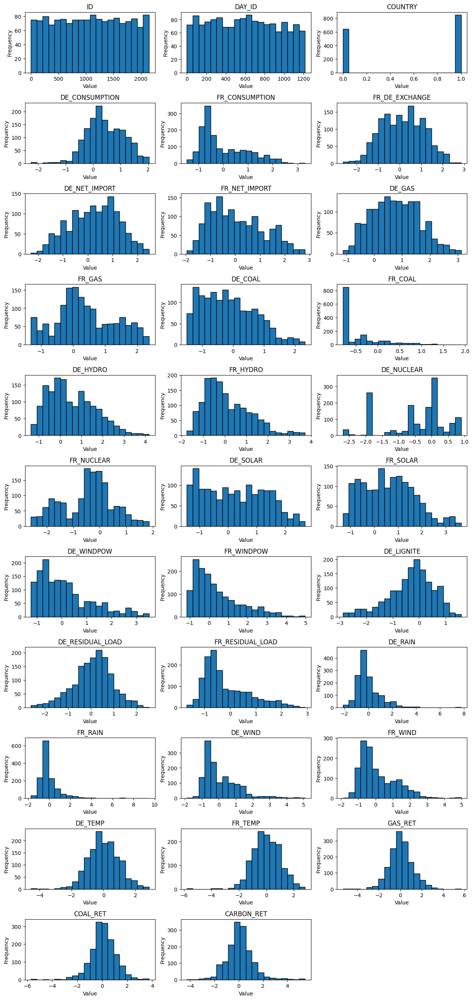

In [ ]:
subplots_per_row = 3
num_columns = X_train_encoded.shape[1]
num_rows = (num_columns // subplots_per_row) + (num_columns % subplots_per_row > 0)

# Create subplots
fig, axes = plt.subplots(num_rows, subplots_per_row, figsize=(15, 3 * num_rows))
fig.subplots_adjust(hspace=0.5)  # Adjust vertical spacing

# Flatten the axes array to simplify indexing
axes = axes.flatten()

# Plot histograms for each column
for i, column in enumerate(X_train_encoded.columns):
    axes[i].hist(X_train_encoded[column].dropna(), bins=20, edgecolor='black')
    axes[i].set_title(column)
    axes[i].set_xlabel('Value')
    axes[i].set_ylabel('Frequency')

# Hide empty subplots
for i in range(num_columns, len(axes)):
    axes[i].axis('off')

plt.show()

##Data Cleaning(2nd)

Given the statistical patterns and descriptive statistics, we would like to see that most columns with missing values show some skewness in the distribution, so fill in the missing value with the medians seem to be more fair.

In [12]:

# Assuming cols_to_fill is a list of columns to fill NaN values
cols_to_fill = ['FR_DE_EXCHANGE', 'DE_NET_IMPORT', 'FR_NET_IMPORT', 'DE_RAIN', 'FR_RAIN', 'DE_WIND', 'FR_WIND', 'DE_TEMP', 'FR_TEMP']

# Fill NaN values with median for each column
X_train_encoded[cols_to_fill] = X_train_encoded[cols_to_fill].fillna(X_train_encoded[cols_to_fill].median())

print(X_train_encoded.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1494 entries, 0 to 1493
Data columns (total 32 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   ID                1494 non-null   int64  
 1   DAY_ID            1494 non-null   int64  
 2   COUNTRY           1494 non-null   int64  
 3   DE_CONSUMPTION    1494 non-null   float64
 4   FR_CONSUMPTION    1494 non-null   float64
 5   FR_DE_EXCHANGE    1494 non-null   float64
 6   DE_NET_IMPORT     1494 non-null   float64
 7   FR_NET_IMPORT     1494 non-null   float64
 8   DE_GAS            1494 non-null   float64
 9   FR_GAS            1494 non-null   float64
 10  DE_COAL           1494 non-null   float64
 11  FR_COAL           1494 non-null   float64
 12  DE_HYDRO          1494 non-null   float64
 13  FR_HYDRO          1494 non-null   float64
 14  DE_NUCLEAR        1494 non-null   float64
 15  FR_NUCLEAR        1494 non-null   float64
 16  DE_SOLAR          1494 non-null   float64


#Correlation Analysis

In [ ]:
# Compute the correlation matrix
correlation_matrix = X_train_encoded.corr()


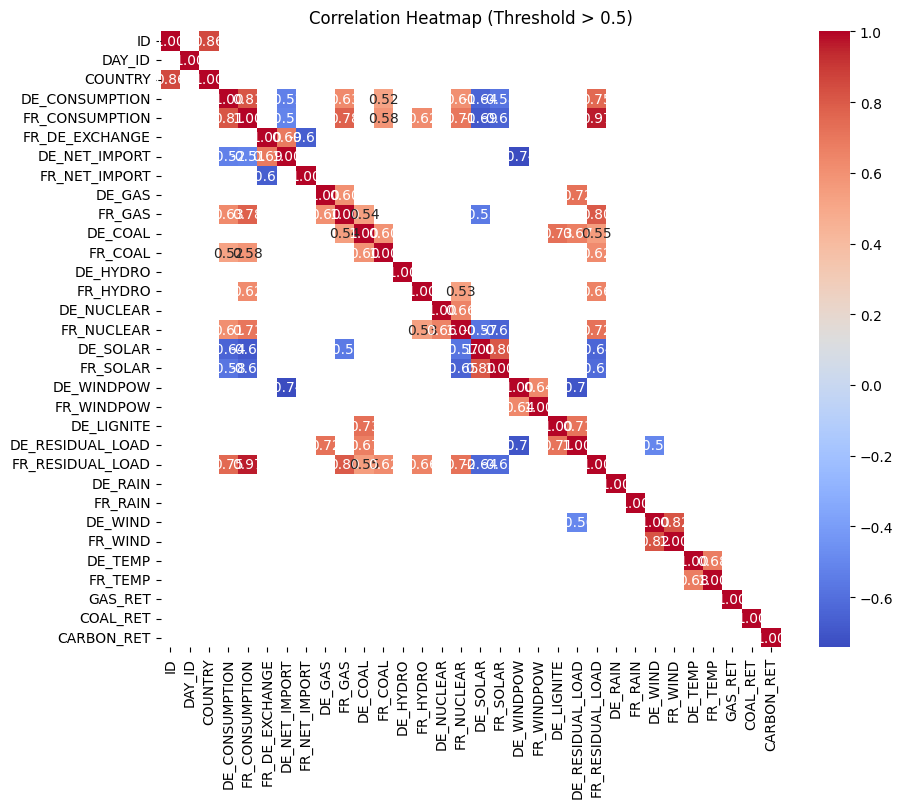

In [ ]:
# Set correlation threshold
threshold = 0.5

# Filter correlations above threshold
corr_above_threshold = correlation_matrix[correlation_matrix.abs() > threshold]

# Create heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_above_threshold, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap (Threshold > 0.5)')
plt.show()

Considering the country differences, we would like to know the correlation analysis on different country data.


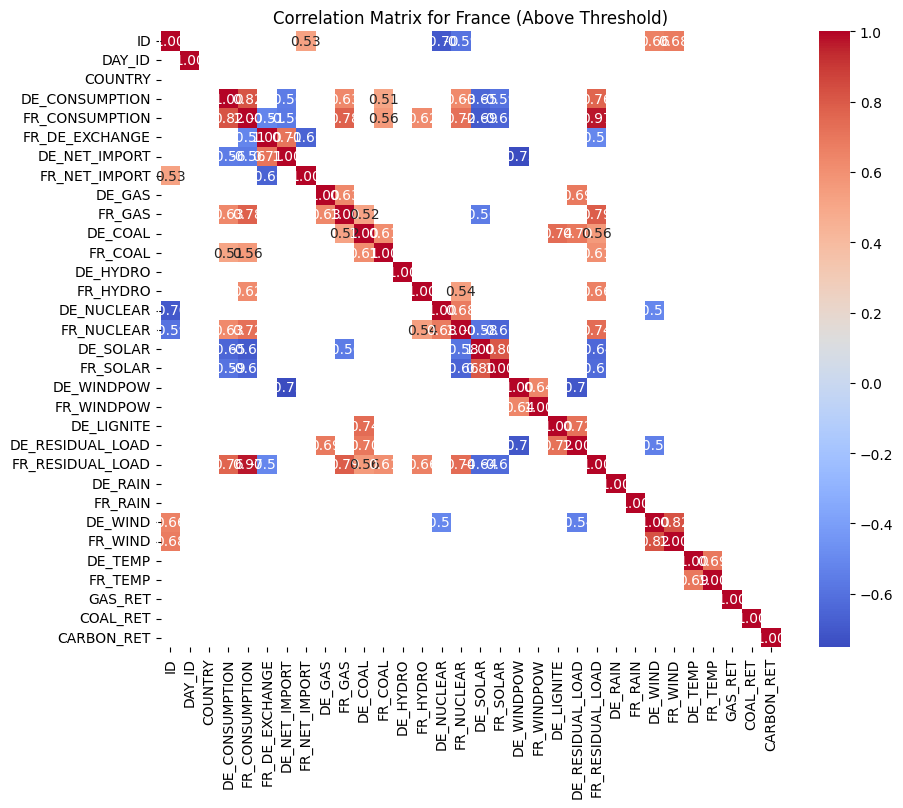

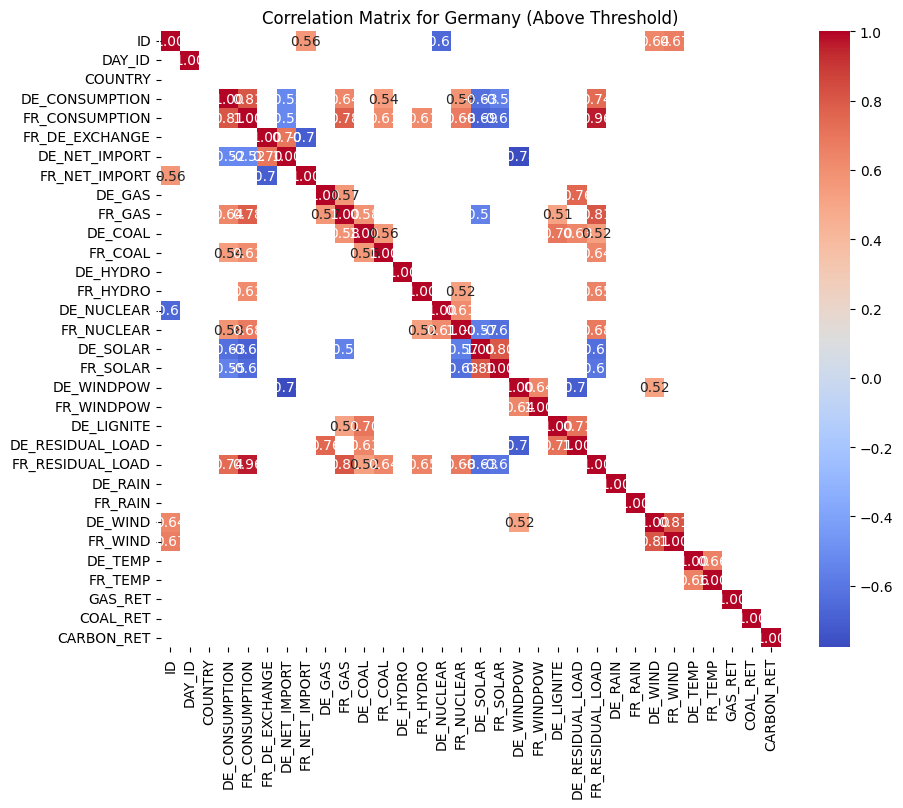

In [9]:
# Separate the dataset into subsets for France and Germany
df_france = X_train_encoded[X_train_encoded['COUNTRY'] == 1]
df_germany = X_train_encoded[X_train_encoded['COUNTRY'] == 0]

# Compute correlation matrices for France and Germany
correlation_matrix_france = df_france.corr()
correlation_matrix_germany = df_germany.corr()

# Set correlation threshold
threshold = 0.5  # Adjust as needed

# Filter correlations above or below threshold for France
corr_above_threshold_france = correlation_matrix_france[correlation_matrix_france.abs() > threshold]
corr_below_threshold_france = correlation_matrix_france[correlation_matrix_france.abs() < threshold]

# Filter correlations above or below threshold for Germany
corr_above_threshold_germany = correlation_matrix_germany[correlation_matrix_germany.abs() > threshold]
corr_below_threshold_germany = correlation_matrix_germany[correlation_matrix_germany.abs() < threshold]

# Visualize correlation matrix for France above threshold
plt.figure(figsize=(10, 8))
sns.heatmap(corr_above_threshold_france, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix for France (Above Threshold)')
plt.show()

# Visualize correlation matrix for Germany above threshold
plt.figure(figsize=(10, 8))
sns.heatmap(corr_above_threshold_germany, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix for Germany (Above Threshold)')
plt.show()

In [10]:
print(X_train_encoded.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1494 entries, 0 to 1493
Data columns (total 32 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   ID                1494 non-null   int64  
 1   DAY_ID            1494 non-null   int64  
 2   COUNTRY           1494 non-null   int64  
 3   DE_CONSUMPTION    1494 non-null   float64
 4   FR_CONSUMPTION    1494 non-null   float64
 5   FR_DE_EXCHANGE    1469 non-null   float64
 6   DE_NET_IMPORT     1370 non-null   float64
 7   FR_NET_IMPORT     1424 non-null   float64
 8   DE_GAS            1494 non-null   float64
 9   FR_GAS            1494 non-null   float64
 10  DE_COAL           1494 non-null   float64
 11  FR_COAL           1494 non-null   float64
 12  DE_HYDRO          1494 non-null   float64
 13  FR_HYDRO          1494 non-null   float64
 14  DE_NUCLEAR        1494 non-null   float64
 15  FR_NUCLEAR        1494 non-null   float64
 16  DE_SOLAR          1494 non-null   float64


In [ ]:
X_train_encoded.to_csv('X_train_encoded.csv', index=False)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

MessageError: Error: credential propagation was unsuccessful

##t-SNE

t-SNE is used when visually exploring high dimensional data set. We just want to discover more on the dataset.

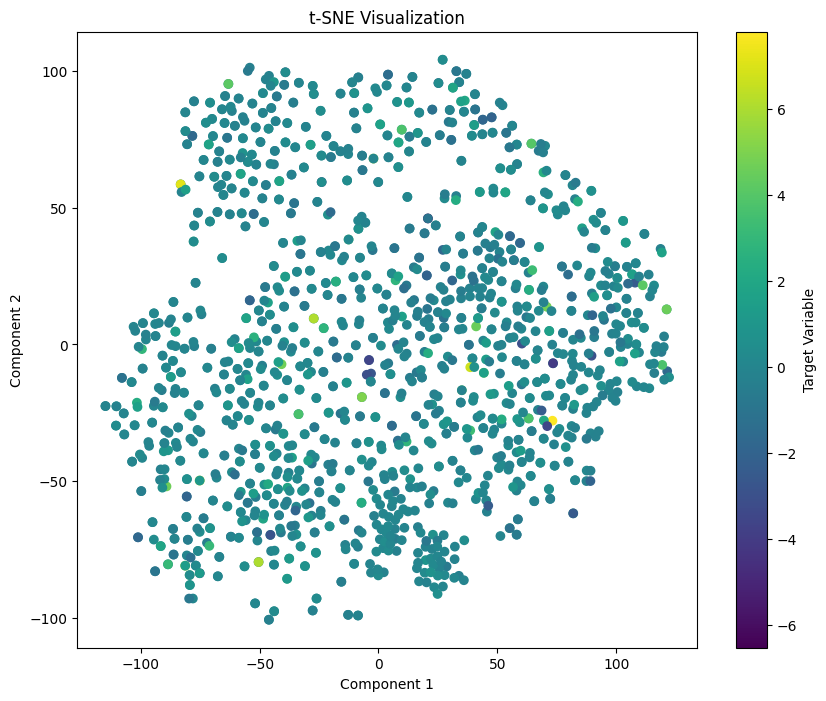

In [ ]:
from sklearn.manifold import TSNE

# X_train_encoded is the feature matrix (excluding the target variable)
# y_train is the target variable
# 'ID' is the common unique identifier for each row in both X_train_encoded and y_train
#create a dataframe for tSNE
X_train_for_tsne = X_train_encoded.copy()

# Merge X_train_encoded and y_train on the 'ID' column
df_merged = pd.merge(X_train_for_tsne, Y_train, on='ID')

# Extract the feature matrix (excluding the 'ID' and target variable columns)
X_features = df_merged.drop(['ID','DAY_ID','COUNTRY','TARGET'], axis=1)

# Extract the target variable
y_target = df_merged['TARGET']

# Instantiate t-SNE with desired parameters
tsne = TSNE(n_components=2, random_state=42)

# Fit t-SNE to the feature matrix
X_embedded = tsne.fit_transform(X_features)

# Visualize the embedded data (2D scatter plot)
plt.figure(figsize=(10, 8))
plt.scatter(X_embedded[:, 0], X_embedded[:, 1], c=y_target, cmap='viridis')
plt.title('t-SNE Visualization')
plt.xlabel('Component 1')
plt.ylabel('Component 2')
plt.colorbar(label='Target Variable')
plt.show()

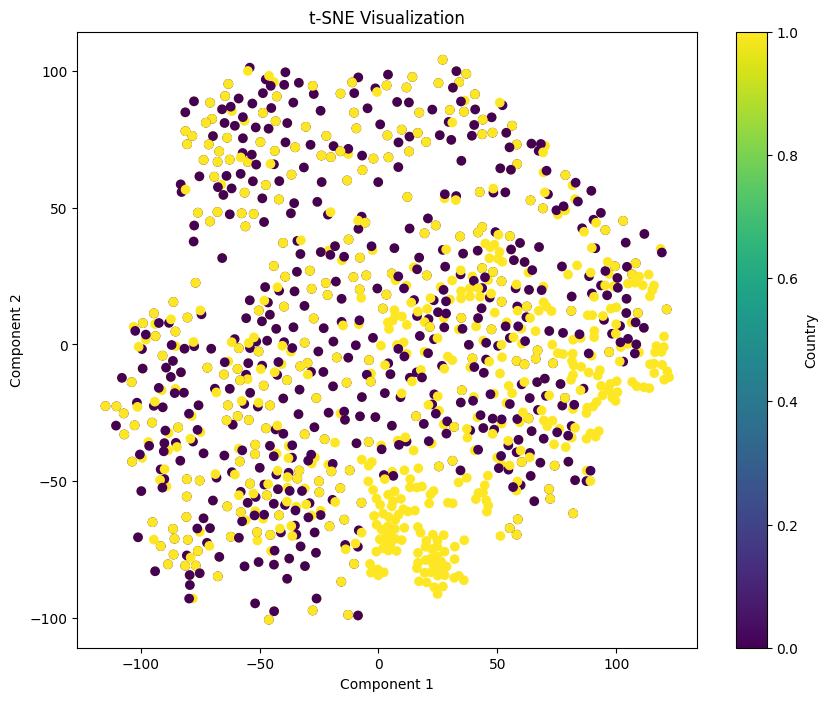

In [ ]:
from sklearn.manifold import TSNE

# X_train_encoded is the feature matrix (excluding the target variable)
# y_train is the target variable
# 'ID' is the common unique identifier for each row in both X_train_encoded and y_train
#create a dataframe for tSNE
X_train_for_tsne = X_train_encoded.copy()

# Merge X_train_encoded and y_train on the 'ID' column
df_merged = pd.merge(X_train_for_tsne, Y_train, on='ID')

# Extract the feature matrix (excluding the 'ID' and target variable columns)
X_features = df_merged.drop(['ID','DAY_ID','COUNTRY','TARGET'], axis=1)

# Extract the target variable
y_target = df_merged['TARGET']

# Instantiate t-SNE with desired parameters
tsne = TSNE(n_components=2, random_state=42)

# Fit t-SNE to the feature matrix
X_embedded = tsne.fit_transform(X_features)

# Visualize the embedded data (2D scatter plot)
plt.figure(figsize=(10, 8))
plt.scatter(X_embedded[:, 0], X_embedded[:, 1], c=X_train_for_tsne['COUNTRY'], cmap='viridis')
plt.title('t-SNE Visualization')
plt.xlabel('Component 1')
plt.ylabel('Component 2')
plt.colorbar(label='Country')
plt.show()

##PCA


In [ ]:

from sklearn.decomposition import PCA
#apply pca to reduce the dimension into 2D
# Create a copy of X_train_encoded with a different name
df_PCA = X_train_encoded.copy()

# Define columns to delete from df_PCA
columns_to_delete_PCA = ['ID', 'DAY_ID','COUNTRY']

# Drop specified columns from df_PCA
df_PCA.drop(columns=columns_to_delete_PCA, inplace=True)

# Create a pairplot to inspect df_PCA
sns.pairplot(df_PCA)

plt.show()


In [ ]:

from sklearn.preprocessing import StandardScaler

# Scale the data
scaler = StandardScaler()
df_std = scaler.fit_transform(X_train_encoded)

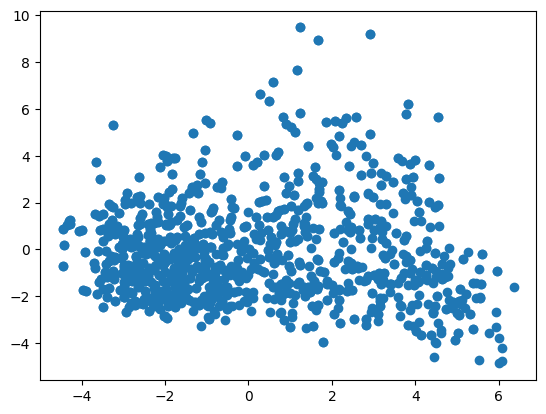

In [ ]:

from sklearn.decomposition import PCA
#apply pca to reduce the dimension into 2D
# Create a copy of X_train_encoded with a different name
df_PCA = X_train_encoded.copy()

# Define columns to delete from df_PCA
columns_to_delete_PCA = ['ID', 'COUNTRY','DAY_ID']

# Drop specified columns from df_PCA
df_PCA.drop(columns=columns_to_delete_PCA, inplace=True)

# Apply PCA to reduce the dimensionality to 2D
pca = PCA(n_components=2)
pca_result = pca.fit_transform(df_PCA)
df_pca = pd.DataFrame(data = pca_result, columns = ['PC1', 'PC2'])
plt.scatter(df_pca['PC1'], df_pca['PC2'])

In [ ]:

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Scale the data
scaler = StandardScaler()
df_std = scaler.fit_transform(X_train_encoded)

# Apply PCA
pca = PCA()
pca.fit(df_std)

# Inspect the explained variance ratio per component
print(pca.explained_variance_ratio_)


[2.40637606e-01 1.46856918e-01 1.00647768e-01 5.75631019e-02
 5.55029421e-02 5.28335855e-02 4.41565995e-02 3.44360296e-02
 3.13999934e-02 3.04920688e-02 2.63708684e-02 2.56426409e-02
 2.29432728e-02 2.05399644e-02 1.67714641e-02 1.42308775e-02
 1.25288861e-02 1.18954411e-02 9.29271840e-03 8.10875369e-03
 7.41876418e-03 5.95331214e-03 5.62094335e-03 5.42292116e-03
 4.40388682e-03 3.69562052e-03 1.98195554e-03 1.59317815e-03
 5.88144367e-04 3.49614525e-04 1.12086452e-04 8.07242495e-06]


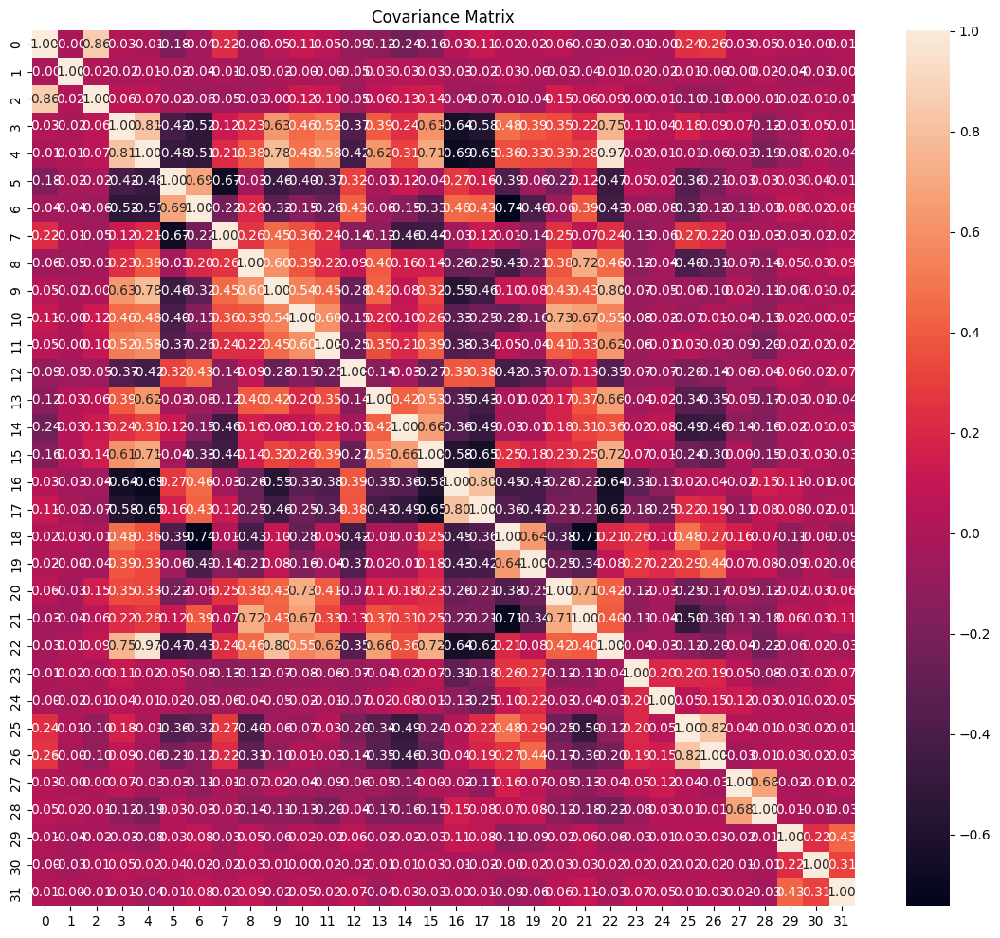

In [ ]:

#plot covariance matrix
cov_matrix = np.cov(df_std, rowvar=False)

plt.figure(figsize=(14, 12))
sns.heatmap(cov_matrix, annot=True, fmt='.2f')
plt.title('Covariance Matrix')
plt.show()

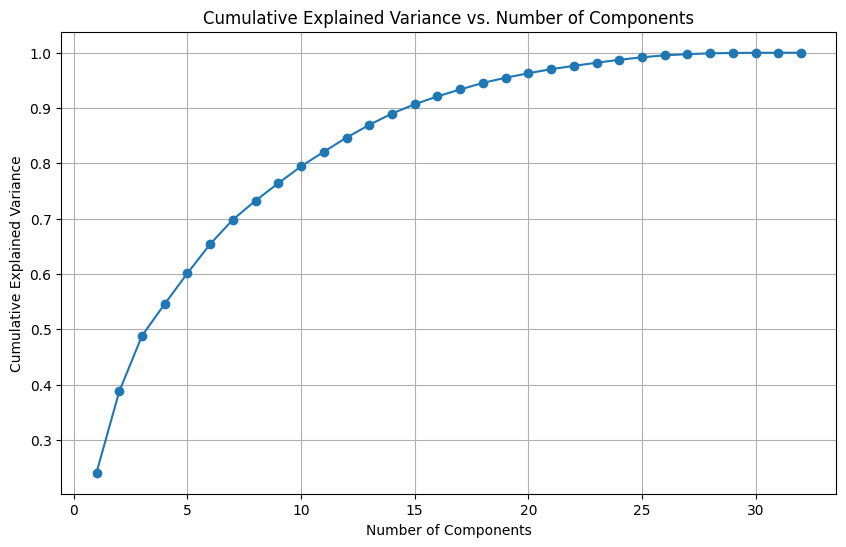

In [ ]:

# Apply PCA with different number of components
n_components_range = range(1, df_std.shape[1] + 1)  # Range of number of components to try
cumulative_variances = []  # List to store cumulative explained variances

for n_components in n_components_range:
    pca = PCA(n_components=n_components)
    pca.fit(df_std)
    cumulative_variance = sum(pca.explained_variance_ratio_)  # Compute cumulative explained variance
    cumulative_variances.append(cumulative_variance)

# Plot cumulative explained variance vs. number of components
plt.figure(figsize=(10, 6))
plt.plot(n_components_range, cumulative_variances, marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Cumulative Explained Variance vs. Number of Components')
plt.grid(True)
plt.show()

# DecisionTreeRegressor

# Model Training

In [13]:
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error, r2_score
from scipy.stats import spearmanr

# Merge X train and Y train dataframes based on 'ID'
train_df = X_train_encoded.merge(Y_train, on='ID')

# Drop the 'ID' column from the merged dataframe
train_df.drop(columns=['ID'], inplace=True)

train_df.drop(columns=['FR_RESIDUAL_LOAD', 'DAY_ID'], inplace=True)

# Split the merged dataframe into features (X_train) and target variable (y_train)
X_train = train_df.drop(columns=['TARGET'])
y_train = train_df['TARGET']

# Step 3: Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X_train, y_train, test_size=0.3, random_state=42)

# Step 4: Model Training
# Train a DecisionTreeRegressor model on the training data
model = DecisionTreeRegressor(random_state=42)
model.fit(X_train, y_train)

# Step 5: Hyperparameter Tuning
param_grid = {"max_depth": [None, 10, 20, 30],
               "min_samples_split": [2, 5, 10],
               "min_samples_leaf": [1, 2, 4]}
grid_search = GridSearchCV(model, param_grid, cv=5)
grid_search.fit(X_train, y_train)
best_params = grid_search.best_params_
print("Best parameters:", best_params)

# Step 6: Model Evaluation
# Evaluate the model's performance on the testing set using metrics such as Mean Squared Error (MSE), R-squared, and Spearman correlation coefficient
y_pred = grid_search.best_estimator_.predict(X_test)

# Calculate Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error (MSE):", mse)

# Calculate R-squared
r_squared = r2_score(y_test, y_pred)
print("R-squared:", r_squared)

# Calculate Spearman correlation coefficient
spearman_corr, _ = spearmanr(y_test, y_pred)
print("Spearman correlation coefficient:", spearman_corr)

Best parameters: {'max_depth': 10, 'min_samples_leaf': 4, 'min_samples_split': 10}
Mean Squared Error (MSE): 1.2841293330661894
R-squared: -0.1636292997039568
Spearman correlation coefficient: 0.2010559847924192


#Test Data Cleaning

In [14]:
#clean X_test
X_test_final = pd.read_csv('/content/X_test_final.csv')
columns_to_drop1 = ['FR_NET_EXPORT', 'DE_NET_EXPORT', 'DE_FR_EXCHANGE']

X_test_final.drop(columns = columns_to_drop1, inplace=True)


# Assuming cols_to_fill1 is a list of columns to fill NaN values
cols_to_fill1 = ['FR_DE_EXCHANGE', 'DE_NET_IMPORT', 'FR_NET_IMPORT', 'DE_RAIN', 'FR_RAIN', 'DE_WIND', 'FR_WIND', 'DE_TEMP', 'FR_TEMP']

# Fill NaN values with median for each column
X_test_final[cols_to_fill1] = X_test_final[cols_to_fill1].fillna(X_train_encoded[cols_to_fill1].median())

# Define the mapping for encoding countries
country_encoding = {'FR': 1, 'DE': 0}

# Create a new DataFrame X_train_encoded
X_test_FINAL = X_test_final.copy()

# Encode the country column in df_encoded
X_test_FINAL['COUNTRY'] = X_test_FINAL['COUNTRY'].map(country_encoding)



In [15]:
Y_test_random_final = pd.read_csv('/content/y_test_random_final.csv')


In [16]:
# Merge X train and Y train dataframes based on 'ID'
test_df = X_test_FINAL.merge(Y_test_random_final, on='ID')

# Drop the 'ID' column from the merged dataframe
test_df.drop(columns=['ID'], inplace=True)

test_df.drop(columns=['FR_RESIDUAL_LOAD', 'DAY_ID'], inplace=True)

# Split the merged dataframe into features (X_train) and target variable (y_train)
X_TEST = test_df.drop(columns=['TARGET'])
Y_TEST = test_df['TARGET']

In [17]:
Y_TEST_pred = grid_search.best_estimator_.predict(X_TEST)
# Calculate Mean Squared Error (MSE)
mse1 = mean_squared_error(Y_TEST, Y_TEST_pred)
print("Mean Squared Error (MSE):", mse1)

# Calculate R-squared
r_squared1 = r2_score(Y_TEST, Y_TEST_pred)
print("R-squared:", r_squared1)

# Calculate Spearman correlation coefficient
spearman_corr1, _ = spearmanr(Y_TEST, Y_TEST_pred)
print("Spearman correlation coefficient:", spearman_corr1)

Mean Squared Error (MSE): 1.4707981733288564
R-squared: -0.3948790874525261
Spearman correlation coefficient: 0.07416904333599676
